In [15]:
import pandas as pd
import geopandas as gpd
import acbm

from libpysal.weights import Queen

from acbm.assigning.select_facility import (
    select_facility,
    map_activity_locations
)
from acbm.assigning.plots import (
    plot_scatter_actual_reported,
    plot_desire_lines
)

from acbm.logger_config import assigning_facility_locations_logger as logger

In [2]:
activity_chains = pd.read_csv(
    acbm.root_path / "data/processed/activities_pam/legs.csv"
)

activity_chains = activity_chains.drop(columns=["Unnamed: 0", "freq"])

In [3]:
activity_chains.head(5)

,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00
1,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,0:45:00
2,199,89,E00059031,E00057787,shop,home,shop,car,3.0,1900-01-01 12:00:00,1900-01-01 12:10:00,0:10:00
3,199,89,E00057787,E00059031,home,shop,home,car,4.0,1900-01-01 12:45:00,1900-01-01 12:55:00,0:10:00
4,199,89,E00059031,E00058564,work,home,work,car,5.0,1900-01-01 13:30:00,1900-01-01 13:50:00,0:20:00


In [4]:
# Group by 'mode' and 'purp' and count the occurrences
mode_purp_counts = activity_chains.groupby(['mode', 'purp']).size().reset_index(name='counts')

# Display the result
print(mode_purp_counts)

    mode       purp  counts
0   bike  education       5
1   bike     escort       6
2   bike       home     158
3   bike    medical       3
4   bike      other      65
5   bike       shop      16
6   bike      visit      10
7   bike       work      70
8    car  education     235
9    car     escort    1584
10   car       home    4864
11   car    medical     134
12   car      other    1761
13   car       shop    1039
14   car      visit     691
15   car       work    1139
16    pt  education      85
17    pt     escort      57
18    pt       home     740
19    pt    medical      34
20    pt      other     185
21    pt       shop      86
22    pt      visit      85
23    pt       work     364
24  walk  education      64
25  walk     escort      61
26  walk       home     711
27  walk    medical      10
28  walk      other     476
29  walk       shop      94
30  walk      visit      43
31  walk       work     100


In [5]:
activity_chains_home = activity_chains[activity_chains["destination activity"] == "home"]
activity_chains_work = activity_chains[activity_chains["destination activity"] == "work"]
activity_chains_edu = activity_chains[activity_chains["destination activity"] == "education"]
# secondary activities
activities_to_exclude = ["home", "work", "education"]
activity_chains_other = activity_chains[~activity_chains["destination activity"].isin(activities_to_exclude)]


## POI data

In [6]:
osm_data_gdf = gpd.read_parquet(
    acbm.root_path / "data/external/boundaries/west-yorkshire_epsg_4326.parquet"
)

#osm_data_gdf = gpd.GeoDataFrame(osm_data_gdf, geometry="geometry", crs="EPSG:4326")

## Boundary data

In [7]:
where_clause = "MSOA21NM LIKE '%Leeds%'"

boundaries = gpd.read_file(
    acbm.root_path / "data/external/boundaries/oa_england.geojson", where=where_clause
)

boundaries = boundaries.to_crs(epsg=4326)

## Add zone column (OA21CD) to POI data

In [8]:
# ensure that osm_data_gdf and boundaries are in the same crs
osm_data_gdf = osm_data_gdf.to_crs(boundaries.crs)

osm_data_gdf = gpd.sjoin(
    osm_data_gdf, boundaries[["OA21CD", "geometry"]], how="inner", predicate="within"
)

osm_data_gdf.head(10)

,id,activities,geometry,units,levels,area,floor_area,distance_to_nearest_transit,distance_to_nearest_shop,distance_to_nearest_medical,index_right,OA21CD
0,643657,transit,POINT (-1.50849 53.76233),1.0,1.0,0,0.0,0.000000,109.755337,1883.754159,983,E00057795
1,20621535,home,POINT (-1.56566 53.81375),1.0,2.0,0,0.0,198.493258,108.072976,255.853754,851,E00057657
2,21591858,home,POINT (-1.63279 53.87138),1.0,2.0,0,0.0,969.484065,509.809989,2318.285507,557,E00057349
3,27325240,transit,POINT (-1.66533 53.90971),1.0,1.0,0,0.0,0.000000,578.769135,1673.801938,1504,E00058347
4,27348238,transit,POINT (-1.63022 53.90354),1.0,1.0,0,0.0,0.000000,95.392235,3927.514412,1542,E00058385
5,27411630,home,POINT (-1.72353 53.90655),1.0,2.0,0,0.0,216.265895,986.041911,1716.667311,1524,E00058367
7,27470976,home,POINT (-1.56251 53.90203),1.0,2.0,0,0.0,873.984192,1799.502624,3250.842461,1478,E00058319
8,27475939,"work,shop",POINT (-1.38550 53.92917),1.0,1.0,0,0.0,13.691226,0.000000,276.210958,2148,E00059036
9,27563268,transit,POINT (-1.71095 53.91335),1.0,1.0,0,0.0,0.000000,521.696581,653.499530,1531,E00058374
10,27652981,"work,other",POINT (-1.69244 53.90651),1.0,2.0,0,0.0,105.789961,5.964285,75.326150,1506,E00058349


# Assign point locations

## 1. Get neighboring zones

Sometimes, an activity can be assigned to a zone, but there are no facilities
in the zone that match the activity type. In this case, we can search for matching
facilities in neighboring zones.

In [9]:
# get neighbors 
zone_neighbors = Queen.from_dataframe(boundaries, idVariable="OA21CD").neighbors

/tmp/ipykernel_229728/3225486215.py:2: FutureWarning: `idVariable` is deprecated and will be removed in future. Use `ids` instead.
  zone_neighbors = Queen.from_dataframe(boundaries, idVariable="OA21CD").neighbors


## 2. Assign: Home

### Calculate a home location only once per household


In [10]:
# Keep one row per household and select only household and OA21CD columns
activity_chains_home_hh = activity_chains_home.drop_duplicates(subset=["hid"])
activity_chains_home_hh = activity_chains_home_hh[["hid", "destination activity", "dzone"]]
activity_chains_home_hh.head(10)

,hid,destination activity,dzone
1,89,home,E00059031
11,139,home,E00059045
17,197,home,E00059023
21,283,home,E00059012
31,342,home,E00059033
33,371,home,E00059016
41,621,home,E00059021
46,645,home,E00059015
52,892,home,E00059011
56,1156,home,E00059023


In [11]:
activity_locations_home = select_facility(
    df = activity_chains_home_hh,
    unique_id_col="hid",
    facilities_gdf=osm_data_gdf,
    row_destination_zone_col="dzone",
    row_activity_type_col="destination activity",
    gdf_facility_zone_col="OA21CD",
    gdf_facility_type_col="activities",
    gdf_sample_col="floor_area",
    neighboring_zones=zone_neighbors,
)

dict(list(activity_locations_home.items())[0:5])

/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodat

{89: ('1735589216', <POINT (-1.396 53.934)>),
 139: ('1750469986', <POINT (-1.402 53.927)>),
 197: ('1730186346', <POINT (-1.394 53.94)>),
 283: ('1792480784', <POINT (-1.387 53.941)>),
 342: ('1686380960', <POINT (-1.406 53.931)>)}

In [16]:
# Map the activity_id and activity_geometry to the activity_chains_home_df DataFrame
activity_chains_home = map_activity_locations(
    activity_chains_df=activity_chains_home, 
    activity_locations_dict=activity_locations_home, 
    id_col='hid')

activity_chains_home.head(10)

/tmp/ipykernel_125454/2295549279.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_df['end_location_id'] = activity_chains_df[id_col].map(
/tmp/ipykernel_125454/2295549279.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_df['end_location_geometry'] = activity_chains_df[id_col].map(


,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,end_location_id,end_location_geometry
1,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346)
3,199,89,E00057787,E00059031,home,shop,home,car,4.0,1900-01-01 12:45:00,1900-01-01 12:55:00,0:10:00,1736846224,POINT (-1.3972101197321274 53.934216722150346)
5,199,89,E00059031,E00059031,home,work,home,car,6.0,1900-01-01 20:30:00,1900-01-01 21:00:00,0:30:00,1736846224,POINT (-1.3972101197321274 53.934216722150346)
7,200,89,E00056934,E00059031,home,escort,home,car,2.0,1900-01-01 15:30:00,1900-01-01 15:50:00,0:20:00,1736846224,POINT (-1.3972101197321274 53.934216722150346)
9,201,89,E00059031,E00059031,home,education,home,car,2.0,1900-01-01 15:30:00,1900-01-01 15:50:00,0:20:00,1736846224,POINT (-1.3972101197321274 53.934216722150346)
11,312,139,E00059045,E00059045,home,work,home,car,2.0,1900-01-01 22:02:00,1900-01-01 22:03:00,0:01:00,1743398838,POINT (-1.3947946922996228 53.93067910167513)
15,313,139,E00059025,E00059045,home,escort,home,car,4.0,1900-01-01 22:02:00,1900-01-01 22:03:00,0:01:00,1743398838,POINT (-1.3947946922996228 53.93067910167513)
17,425,197,E00057887,E00059023,home,other,home,car,2.0,1900-01-01 11:19:00,1900-01-01 11:32:00,0:13:00,1730012580,POINT (-1.391290967060015 53.938669474886275)
19,425,197,E00169780,E00059023,home,shop,home,car,4.0,1900-01-01 18:14:00,1900-01-01 18:30:00,0:16:00,1730012580,POINT (-1.391290967060015 53.938669474886275)
21,611,283,E00169789,E00059012,home,shop,home,car,4.0,1900-01-01 12:15:00,1900-01-01 12:35:00,0:20:00,1804007134,POINT (-1.3858940998230593 53.93989103937682)


## 3. Assign: Work

In [18]:
activity_locations_work = select_facility(
    df = activity_chains_work,
    unique_id_col="pid",
    facilities_gdf=osm_data_gdf,
    row_destination_zone_col="dzone",
    row_activity_type_col="destination activity",
    gdf_facility_zone_col="OA21CD",
    gdf_facility_type_col="activities",
    gdf_sample_col="floor_area",
    neighboring_zones=zone_neighbors,
)

dict(list(activity_locations_work.items())[0:5])

/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodat

{199: ('390876746', <POINT (-1.503 53.785)>),
 312: ('1739580702', <POINT (-1.394 53.931)>),
 313: ('346422576', <POINT (-1.514 53.773)>),
 1385: ('1278889392', <POINT (-1.461 53.822)>),
 1386: ('524139324', <POINT (-1.385 53.928)>)}

In [31]:
# Map the activity_id and activity_geometry to the activity_chains_df DataFrame
activity_chains_work = map_activity_locations(
    activity_chains_df=activity_chains_work, 
    activity_locations_dict=activity_locations_work, 
    id_col='pid')

activity_chains_work.head(10)

/tmp/ipykernel_125454/2295549279.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_df['end_location_id'] = activity_chains_df[id_col].map(
/tmp/ipykernel_125454/2295549279.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_df['end_location_geometry'] = activity_chains_df[id_col].map(


,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,end_location_id,end_location_geometry
4,199,89,E00059031,E00058564,work,home,work,car,5.0,1900-01-01 13:30:00,1900-01-01 13:50:00,0:20:00,390876746,POINT (-1.5027441415612566 53.78527585420569)
10,312,139,E00059045,E00059045,work,home,work,car,1.0,1900-01-01 06:40:00,1900-01-01 06:41:00,0:01:00,1739580702,POINT (-1.3938668869036623 53.931254847450184)
13,313,139,E00170265,E00057830,work,escort,work,car,2.0,1900-01-01 06:41:00,1900-01-01 07:01:00,0:20:00,346422576,POINT (-1.5144335755896179 53.77335878288022)
45,1385,645,E00059015,E00058794,work,home,work,car,1.0,1900-01-01 08:20:00,1900-01-01 08:50:00,0:30:00,1278889392,POINT (-1.4606490792889804 53.821628185575904)
47,1386,645,E00059015,E00059036,work,home,work,car,1.0,1900-01-01 12:50:00,1900-01-01 12:55:00,0:05:00,524139324,POINT (-1.3847209023923082 53.92842580180659)
51,2016,892,E00059011,E00058422,work,home,work,car,1.0,1900-01-01 07:15:00,1900-01-01 08:00:00,0:45:00,180400792,POINT (-1.6800826044803967 53.80653810149688)
69,3443,1577,E00059024,E00059010,work,home,work,car,1.0,1900-01-01 08:45:00,1900-01-01 09:00:00,0:15:00,2237332902,POINT (-1.3141916714493915 53.91307263619223)
73,3444,1577,E00059024,E00059010,work,home,work,car,1.0,1900-01-01 07:25:00,1900-01-01 07:35:00,0:10:00,433355960,POINT (-1.3211657665145955 53.91985452440156)
83,3859,1773,E00059024,E00058508,work,home,work,car,1.0,1900-01-01 08:00:00,1900-01-01 10:30:00,2:30:00,918026910,POINT (-1.6638481661647906 53.7841807215174)
85,3860,1773,E00059024,E00169780,work,home,work,car,1.0,1900-01-01 06:45:00,1900-01-01 07:15:00,0:30:00,87135578,POINT (-1.5529407184296264 53.80213621769952)


## 4. Assign: Education

We use education_type as a fallback. This has been calculated using age_group_mapping https://github.com/Urban-Analytics-Technology-Platform/acbm/blob/935b3243bf0f8ce9d766d256f33990ca6697f4e4/scripts/2_match_households_and_individuals.py#L1085

In [32]:
# load in activity chains
spc_with_nts = pd.read_parquet(
    acbm.root_path / "data/interim/matching/spc_with_nts_trips.parquet"
)

spc_with_nts.head(5)

,id,household,pid_hs,msoa11cd,oa11cd,members,sic1d2007,sic2d2007,pwkstat,salary_yearly,...,tst,tet,TripDisIncSW,TripDisExSW,TripTotalTime,TripTravTime,ozone,dzone,W5,W5xHH
0,199,89,2906098,E02002330,E00059031,"[199, 200, 201]",C,26.0,1,21491.294922,...,390.0,410.0,13.0,13.0,20.0,20.0,2.0,2.0,0.568328,1.0
1,199,89,2906098,E02002330,E00059031,"[199, 200, 201]",C,26.0,1,21491.294922,...,990.0,1020.0,13.0,13.0,30.0,20.0,2.0,2.0,0.568328,1.0
2,199,89,2906098,E02002330,E00059031,"[199, 200, 201]",C,26.0,1,21491.294922,...,520.0,525.0,1.0,1.0,5.0,5.0,2.0,2.0,0.568328,1.0
3,199,89,2906098,E02002330,E00059031,"[199, 200, 201]",C,26.0,1,21491.294922,...,530.0,535.0,1.0,1.0,5.0,5.0,2.0,2.0,0.568328,1.0
4,199,89,2906098,E02002330,E00059031,"[199, 200, 201]",C,26.0,1,21491.294922,...,890.0,900.0,1.0,1.0,10.0,5.0,2.0,2.0,0.568328,1.0


In [33]:
# we get one row per id
spc_with_nts_edu = spc_with_nts[["id", "education_type"]].drop_duplicates(subset = "id")
spc_with_nts_edu.head(5)

,id,education_type
0,199,education_university
21,200,education_university
45,201,education_school
64,312,education_university
76,313,education_university


In [34]:
# merge the education type with the activity chains
activity_chains_edu = activity_chains_edu.merge(spc_with_nts_edu, left_on="pid", right_on="id", how="left").drop(columns=["id"])
activity_chains_edu.head(5)

,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,education_type
0,201,89,E00059031,E00059030,education,home,education,car,1.0,1900-01-01 08:40:00,1900-01-01 08:45:00,0:05:00,education_school
1,4550,2107,E00059038,E00059036,education,home,education,car,1.0,1900-01-01 08:10:00,1900-01-01 08:30:00,0:20:00,education_school
2,5486,2499,E00059022,E00059023,education,home,education,walk,1.0,1900-01-01 08:05:00,1900-01-01 08:25:00,0:20:00,education_school
3,6310,2834,E00059028,E00059030,education,home,education,walk,1.0,1900-01-01 08:05:00,1900-01-01 08:25:00,0:20:00,education_school
4,9508,4118,E00059025,E00059043,education,home,education,car,1.0,1900-01-01 08:30:00,1900-01-01 08:45:00,0:15:00,education_school


In [35]:
# apply the function to a row in activity_chains_ex
activity_locations_edu = select_facility(
    df = activity_chains_edu,
    unique_id_col="pid",
    facilities_gdf=osm_data_gdf,
    row_destination_zone_col="dzone",
    row_activity_type_col="education_type",
    gdf_facility_zone_col="OA21CD",
    gdf_facility_type_col="activities",
    gdf_sample_col="floor_area",
    neighboring_zones=zone_neighbors,
    fallback_type="education",
)

# show the first five elements in the dictionary
dict(list(activity_locations_edu.items())[0:5])

/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodat

{201: ('160360912', <POINT (-1.391 53.933)>),
 4550: ('24688425', <POINT (-1.39 53.931)>),
 5486: ('2409409', <POINT (-1.389 53.941)>),
 6310: ('160360912', <POINT (-1.391 53.933)>),
 9508: ('25600303', <POINT (-1.379 53.931)>)}

In [36]:
# Map the activity_id and activity_geometry to the activity_chains_home_df DataFrame
activity_chains_edu = map_activity_locations(activity_chains_df=activity_chains_edu, 
                                             activity_locations_dict=activity_locations_edu, 
                                             id_col='pid')

activity_chains_edu.head(10)

,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,education_type,end_location_id,end_location_geometry
0,201,89,E00059031,E00059030,education,home,education,car,1.0,1900-01-01 08:40:00,1900-01-01 08:45:00,0:05:00,education_school,160360912,POINT (-1.3905395371523108 53.93323059983641)
1,4550,2107,E00059038,E00059036,education,home,education,car,1.0,1900-01-01 08:10:00,1900-01-01 08:30:00,0:20:00,education_school,24688425,POINT (-1.3895129981902052 53.930690868751356)
2,5486,2499,E00059022,E00059023,education,home,education,walk,1.0,1900-01-01 08:05:00,1900-01-01 08:25:00,0:20:00,education_school,2409409,POINT (-1.3893578340484058 53.9408016531483)
3,6310,2834,E00059028,E00059030,education,home,education,walk,1.0,1900-01-01 08:05:00,1900-01-01 08:25:00,0:20:00,education_school,160360912,POINT (-1.3905395371523108 53.93323059983641)
4,9508,4118,E00059025,E00059043,education,home,education,car,1.0,1900-01-01 08:30:00,1900-01-01 08:45:00,0:15:00,education_school,25600303,POINT (-1.3788483462935803 53.93096345456586)
5,10184,4474,E00058975,E00058981,education,home,education,car,1.0,1900-01-01 08:00:00,1900-01-01 08:15:00,0:15:00,education_school,12105985,POINT (-1.3534740855059533 53.90352890730664)
6,16842,7377,E00058343,E00058376,education,home,education,car,1.0,1900-01-01 08:15:00,1900-01-01 08:30:00,0:15:00,education_school,175470854,POINT (-1.693069287053999 53.91251424743485)
7,17336,7605,E00058339,E00058345,education,home,education,car,1.0,1900-01-01 08:35:00,1900-01-01 08:55:00,0:20:00,education_school,121323674,POINT (-1.7081158416063476 53.91216123861758)
8,24533,11175,E00058338,E00058345,education,home,education,car,1.0,1900-01-01 07:55:00,1900-01-01 08:00:00,0:05:00,education_kg,281425490,POINT (-1.7071914906836947 53.91213021682614)
9,25434,11574,E00058353,E00058355,education,home,education,car,1.0,1900-01-01 07:46:00,1900-01-01 08:03:00,0:17:00,education_school,174706718,POINT (-1.70241676914788 53.903283772492614)


## 5. Assign: Secondary locations

### Create unique_id column 

pid and hid are not unique id columns, as there can be many different secondary activities done by the same person. 

We create a unique identifier that can be mapped back to the original data.

In [37]:
# Unique id column: Concatenate pid, seq

activity_chains_other["act_id"] = activity_chains_other["pid"].astype(str) + "_" + activity_chains_other["seq"].astype(str)
activity_chains_other.head(5)


/tmp/ipykernel_125454/1860600978.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_other["act_id"] = activity_chains_other["pid"].astype(str) + "_" + activity_chains_other["seq"].astype(str)


,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,act_id
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,199_1.0
2,199,89,E00059031,E00057787,shop,home,shop,car,3.0,1900-01-01 12:00:00,1900-01-01 12:10:00,0:10:00,199_3.0
6,200,89,E00059031,E00056934,escort,home,escort,car,1.0,1900-01-01 12:45:00,1900-01-01 14:00:00,1:15:00,200_1.0
12,313,139,E00059045,E00170265,escort,home,escort,car,1.0,1900-01-01 06:40:00,1900-01-01 06:41:00,0:01:00,313_1.0
14,313,139,E00059045,E00059025,escort,work,escort,car,3.0,1900-01-01 21:40:00,1900-01-01 22:02:00,0:22:00,313_3.0


In [38]:
# apply the function to a row in activity_chains_ex
activity_locations_other = select_facility(
    df = activity_chains_other,
    unique_id_col="act_id",
    facilities_gdf=osm_data_gdf,
    row_destination_zone_col="dzone",
    row_activity_type_col="purp",
    gdf_facility_zone_col="OA21CD",
    gdf_facility_type_col="activities",
    gdf_sample_col="floor_area",
    neighboring_zones=zone_neighbors,
    fallback_to_random=True,
)

dict(list(activity_locations_other.items())[0:5])

/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodataframe.py:1528: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/hussein/.cache/pypoetry/virtualenvs/acbm-7iKwKWLy-py3.10/lib/python3.10/site-packages/geopandas/geodat

{'199_1.0': ('790099150', <POINT (-1.64 53.841)>),
 '199_3.0': ('1127350876', <POINT (-1.532 53.778)>),
 '200_1.0': ('1935597800', <POINT (-1.368 53.767)>),
 '313_1.0': ('357904986', <POINT (-1.535 53.792)>),
 '313_3.0': ('26315405', <POINT (-1.369 53.936)>)}

In [39]:
# Map the activity_id and activity_geometry to the activity_chains_home_df DataFrame
activity_chains_other = map_activity_locations(activity_chains_df=activity_chains_other, 
                                             activity_locations_dict=activity_locations_other, 
                                             id_col='act_id')

activity_chains_other.head(10)

/tmp/ipykernel_125454/2295549279.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_df['end_location_id'] = activity_chains_df[id_col].map(
/tmp/ipykernel_125454/2295549279.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activity_chains_df['end_location_geometry'] = activity_chains_df[id_col].map(


,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,act_id,end_location_id,end_location_geometry
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,199_1.0,790099150,POINT (-1.6403755497689254 53.84066696985774)
2,199,89,E00059031,E00057787,shop,home,shop,car,3.0,1900-01-01 12:00:00,1900-01-01 12:10:00,0:10:00,199_3.0,1127350876,POINT (-1.531659765097034 53.778395747204435)
6,200,89,E00059031,E00056934,escort,home,escort,car,1.0,1900-01-01 12:45:00,1900-01-01 14:00:00,1:15:00,200_1.0,1935597800,POINT (-1.3676894466659053 53.766876271283984)
12,313,139,E00059045,E00170265,escort,home,escort,car,1.0,1900-01-01 06:40:00,1900-01-01 06:41:00,0:01:00,313_1.0,357904986,POINT (-1.534810449151099 53.79244756098901)
14,313,139,E00059045,E00059025,escort,work,escort,car,3.0,1900-01-01 21:40:00,1900-01-01 22:02:00,0:22:00,313_3.0,26315405,POINT (-1.3690522669056258 53.93567481773404)
16,425,197,E00059023,E00057887,other,home,other,car,1.0,1900-01-01 09:00:00,1900-01-01 09:14:00,0:14:00,425_1.0,1022414380,POINT (-1.607217429877327 53.811740511450814)
18,425,197,E00059023,E00169780,shop,home,shop,car,3.0,1900-01-01 17:30:00,1900-01-01 17:42:00,0:12:00,425_3.0,949394246,POINT (-1.5539252385756364 53.80104992471259)
20,611,283,E00059012,E00169789,shop,home,shop,car,3.0,1900-01-01 09:00:00,1900-01-01 09:45:00,0:45:00,611_3.0,408474016,POINT (-1.5392229723012338 53.79577939207494)
22,611,283,E00059012,E00057434,escort,home,escort,car,5.0,1900-01-01 14:20:00,1900-01-01 14:35:00,0:15:00,611_5.0,1857721522,POINT (-1.3819124816822659 53.79524139675378)
24,611,283,E00059012,E00058900,other,home,other,car,7.0,1900-01-01 16:15:00,1900-01-01 16:35:00,0:20:00,611_7.0,858974744,POINT (-1.6078818715034364 53.84069314762899)


# Merge all activity chains data

In [40]:
activity_chains_all = pd.concat([activity_chains_home, activity_chains_work, activity_chains_edu, activity_chains_other])
activity_chains_all = activity_chains_all.sort_values(by=["hid", "pid", "seq"])


# Create start_location_id and start_location_geometry columns

In [41]:
# Create start_location_id and start_location_geometry by shifting end_location_id and end_location_geometry within each 'pid'
activity_chains_all['start_location_id'] = activity_chains_all.groupby('pid')['end_location_id'].shift(1)
activity_chains_all['start_location_geometry'] = activity_chains_all.groupby('pid')['end_location_geometry'].shift(1)

# # Handle NaN values in start_location_id and start_location_geometry (optional)
# # For example, fill NaN with a default value, such as -1 for IDs and 'unknown' for geometries
# activity_chains_all['start_location_id'] = activity_chains_all['start_location_id'].fillna(-1)
# activity_chains_all['start_location_geometry'] = activity_chains_all['start_location_geometry'].fillna('unknown')

activity_chains_all.head(20)

,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,end_location_id,end_location_geometry,education_type,act_id,start_location_id,start_location_geometry
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,790099150,POINT (-1.6403755497689254 53.84066696985774),NaN,199_1.0,NaN,NaN
1,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,790099150,POINT (-1.6403755497689254 53.84066696985774)
2,199,89,E00059031,E00057787,shop,home,shop,car,3.0,1900-01-01 12:00:00,1900-01-01 12:10:00,0:10:00,1127350876,POINT (-1.531659765097034 53.778395747204435),NaN,199_3.0,1736846224,POINT (-1.3972101197321274 53.934216722150346)
3,199,89,E00057787,E00059031,home,shop,home,car,4.0,1900-01-01 12:45:00,1900-01-01 12:55:00,0:10:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,1127350876,POINT (-1.531659765097034 53.778395747204435)
4,199,89,E00059031,E00058564,work,home,work,car,5.0,1900-01-01 13:30:00,1900-01-01 13:50:00,0:20:00,390876746,POINT (-1.5027441415612566 53.78527585420569),NaN,NaN,1736846224,POINT (-1.3972101197321274 53.934216722150346)
5,199,89,E00059031,E00059031,home,work,home,car,6.0,1900-01-01 20:30:00,1900-01-01 21:00:00,0:30:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,390876746,POINT (-1.5027441415612566 53.78527585420569)
6,200,89,E00059031,E00056934,escort,home,escort,car,1.0,1900-01-01 12:45:00,1900-01-01 14:00:00,1:15:00,1935597800,POINT (-1.3676894466659053 53.766876271283984),NaN,200_1.0,NaN,NaN
7,200,89,E00056934,E00059031,home,escort,home,car,2.0,1900-01-01 15:30:00,1900-01-01 15:50:00,0:20:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,1935597800,POINT (-1.3676894466659053 53.766876271283984)
0,201,89,E00059031,E00059030,education,home,education,car,1.0,1900-01-01 08:40:00,1900-01-01 08:45:00,0:05:00,160360912,POINT (-1.3905395371523108 53.93323059983641),education_school,NaN,NaN,NaN
9,201,89,E00059031,E00059031,home,education,home,car,2.0,1900-01-01 15:30:00,1900-01-01 15:50:00,0:20:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,160360912,POINT (-1.3905395371523108 53.93323059983641)


In [42]:
# Fill rows where seq = 1 with the home location
# Create a mask for rows where seq = 1
mask = activity_chains_all['seq'] == 1


# Aggregate duplicates by taking the first occurrence
activity_chains_home_agg = activity_chains_home.groupby('hid').first().reset_index()


# Map home location data to the start_location_id and start_location_geometry columns
activity_chains_all.loc[mask, 'start_location_id'] = activity_chains_all.loc[mask, 'hid'].map(activity_chains_home_agg.set_index('hid')['end_location_id'])
activity_chains_all.loc[mask, 'start_location_geometry'] = activity_chains_all.loc[mask, 'hid'].map(activity_chains_home_agg.set_index('hid')['end_location_geometry'])

activity_chains_all.head(20)


,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,end_location_id,end_location_geometry,education_type,act_id,start_location_id,start_location_geometry
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,790099150,POINT (-1.6403755497689254 53.84066696985774),NaN,199_1.0,1736846224,POINT (-1.3972101197321274 53.934216722150346)
1,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,790099150,POINT (-1.6403755497689254 53.84066696985774)
2,199,89,E00059031,E00057787,shop,home,shop,car,3.0,1900-01-01 12:00:00,1900-01-01 12:10:00,0:10:00,1127350876,POINT (-1.531659765097034 53.778395747204435),NaN,199_3.0,1736846224,POINT (-1.3972101197321274 53.934216722150346)
3,199,89,E00057787,E00059031,home,shop,home,car,4.0,1900-01-01 12:45:00,1900-01-01 12:55:00,0:10:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,1127350876,POINT (-1.531659765097034 53.778395747204435)
4,199,89,E00059031,E00058564,work,home,work,car,5.0,1900-01-01 13:30:00,1900-01-01 13:50:00,0:20:00,390876746,POINT (-1.5027441415612566 53.78527585420569),NaN,NaN,1736846224,POINT (-1.3972101197321274 53.934216722150346)
5,199,89,E00059031,E00059031,home,work,home,car,6.0,1900-01-01 20:30:00,1900-01-01 21:00:00,0:30:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,390876746,POINT (-1.5027441415612566 53.78527585420569)
6,200,89,E00059031,E00056934,escort,home,escort,car,1.0,1900-01-01 12:45:00,1900-01-01 14:00:00,1:15:00,1935597800,POINT (-1.3676894466659053 53.766876271283984),NaN,200_1.0,1736846224,POINT (-1.3972101197321274 53.934216722150346)
7,200,89,E00056934,E00059031,home,escort,home,car,2.0,1900-01-01 15:30:00,1900-01-01 15:50:00,0:20:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,1935597800,POINT (-1.3676894466659053 53.766876271283984)
0,201,89,E00059031,E00059030,education,home,education,car,1.0,1900-01-01 08:40:00,1900-01-01 08:45:00,0:05:00,160360912,POINT (-1.3905395371523108 53.93323059983641),education_school,NaN,1736846224,POINT (-1.3972101197321274 53.934216722150346)
9,201,89,E00059031,E00059031,home,education,home,car,2.0,1900-01-01 15:30:00,1900-01-01 15:50:00,0:20:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),NaN,NaN,160360912,POINT (-1.3905395371523108 53.93323059983641)


In [43]:

# select only the columns we need
activity_chains_all = activity_chains_all[
    ["pid", "hid", "ozone", "dzone", "purp", "origin activity", 
     "destination activity", "mode", "seq", "tst", "tet", "duration", 
     "start_location_id", "start_location_geometry","end_location_id", "end_location_geometry"]
     ]

In [ ]:
# save as parquet
activity_chains_all.to_parquet(acbm.root_path / "data/processed/activities_pam/legs_with_locations.parquet")

# Plot the data 

In [59]:
# merge actual times from the NTS
activity_chains_all_plot = activity_chains_all.merge(
    spc_with_nts[["id", "seq", "TripTotalTime", "TripDisIncSW"]],
    left_on=["pid", "seq"],
    right_on=["id", "seq"],
    how="left"
).drop(columns=["id"])

activity_chains_all_plot.head(1000)

,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,start_location_id,start_location_geometry,end_location_id,end_location_geometry,TripTotalTime,TripDisIncSW
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
1,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),5.0,1.0
2,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),45.0,6.0
3,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
4,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,0:45:00,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,8603,3856,E00059018,E00187029,shop,home,shop,car,1.0,1900-01-01 11:00:00,1900-01-01 11:10:00,0:10:00,524142696,POINT (-1.3860919271770187 53.930582166483624),58037722,POINT (-1.5478279172683373 53.79159169768763),20.0,6.0
996,8603,3856,E00187029,E00169786,other,shop,other,car,2.0,1900-01-01 11:37:00,1900-01-01 12:04:00,0:27:00,58037722,POINT (-1.5478279172683373 53.79159169768763),406267498,POINT (-1.538353198422133 53.79629354711603),13.0,2.0
997,8603,3856,E00187029,E00169786,other,shop,other,car,2.0,1900-01-01 11:37:00,1900-01-01 12:04:00,0:27:00,58037722,POINT (-1.5478279172683373 53.79159169768763),406267498,POINT (-1.538353198422133 53.79629354711603),27.0,5.0
998,8603,3856,E00187029,E00169786,other,shop,other,car,2.0,1900-01-01 11:37:00,1900-01-01 12:04:00,0:27:00,58037722,POINT (-1.5478279172683373 53.79159169768763),406267498,POINT (-1.538353198422133 53.79629354711603),12.0,2.0


In [60]:
# Get unique activity types from the 'purp' column
unique_activity_types = activity_chains_all["purp"].unique()


## Euclidian travel distance vs reported travel times

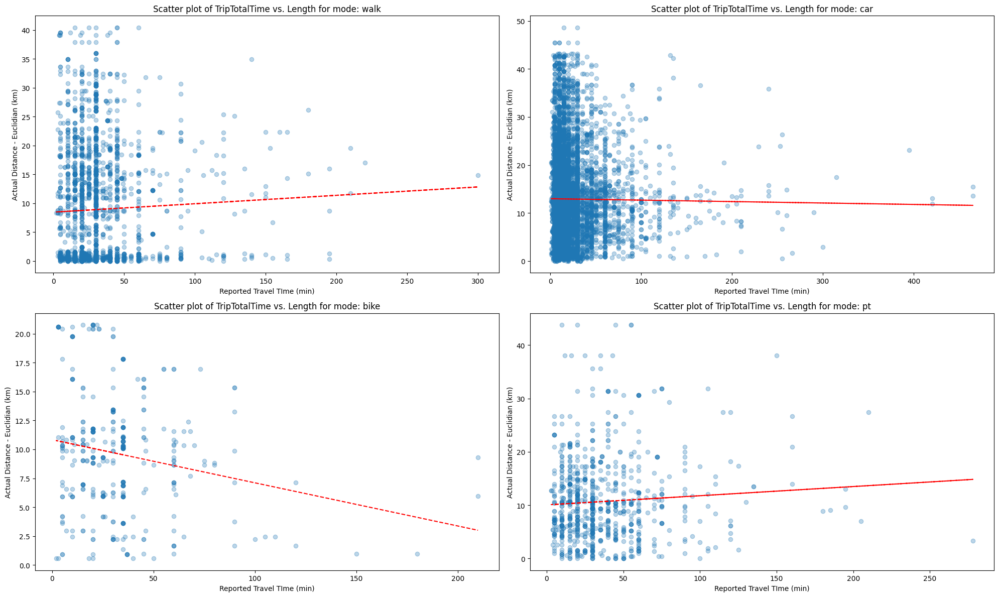

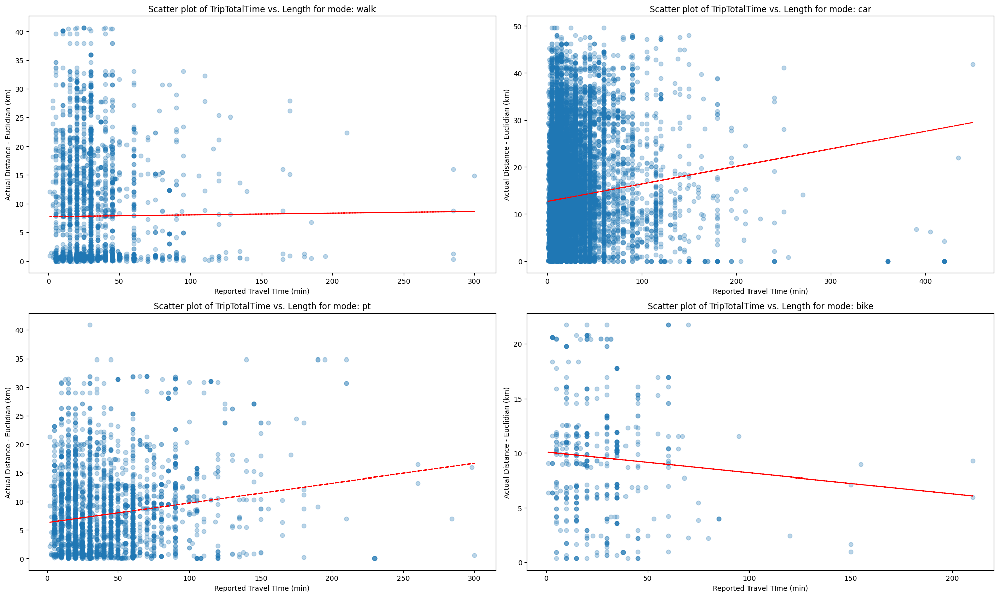

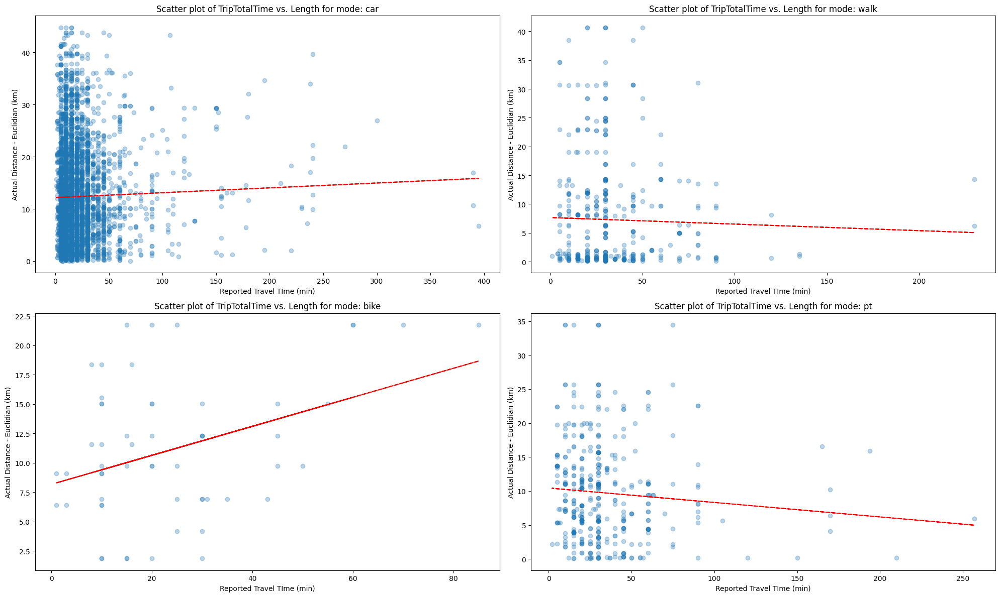

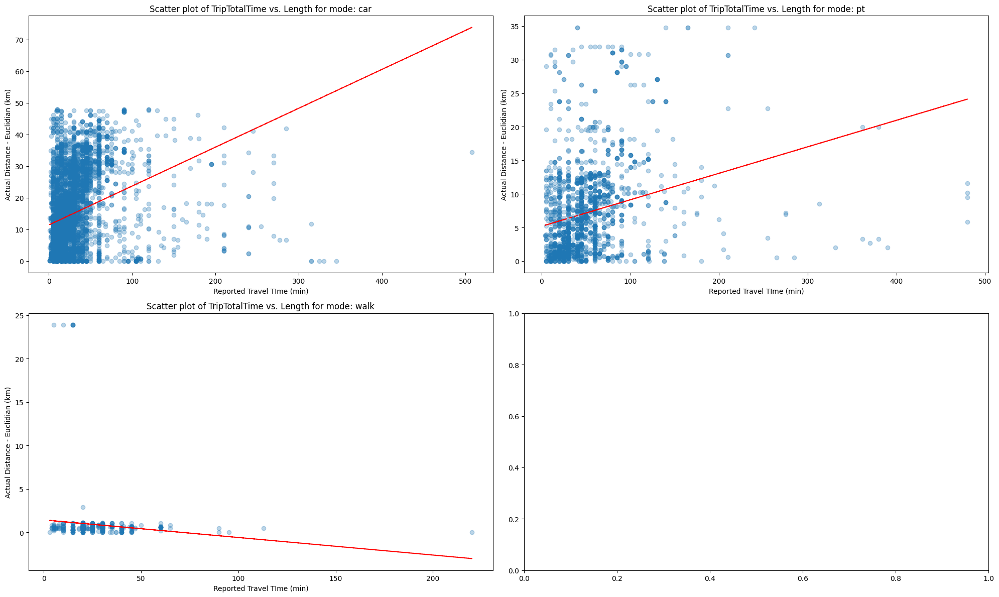

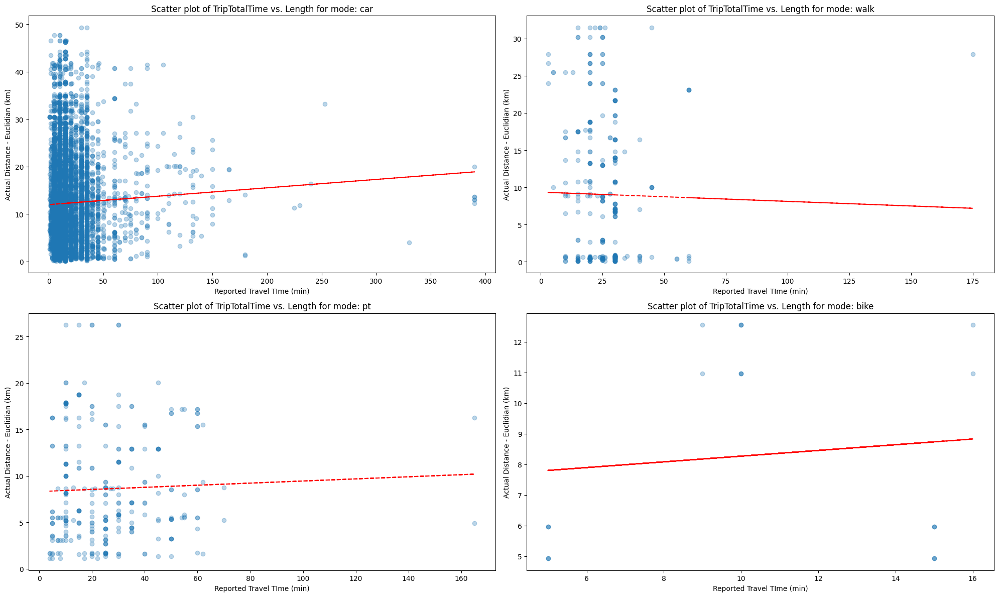

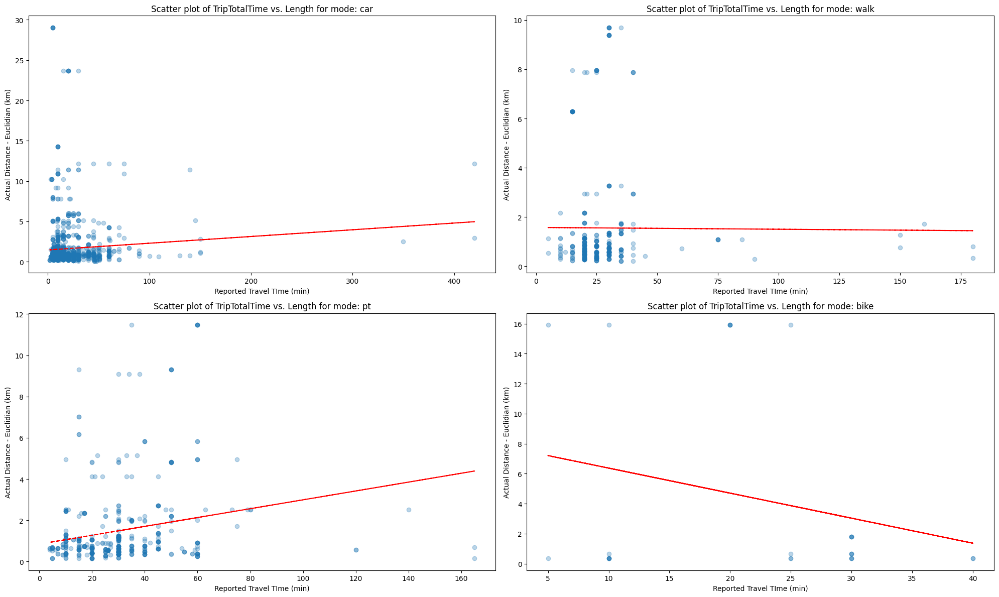

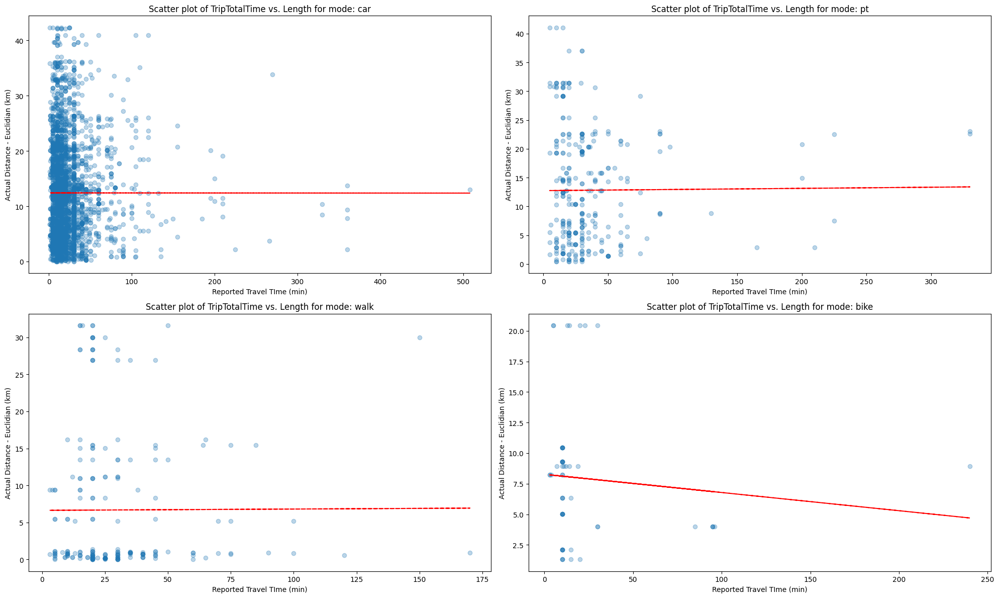

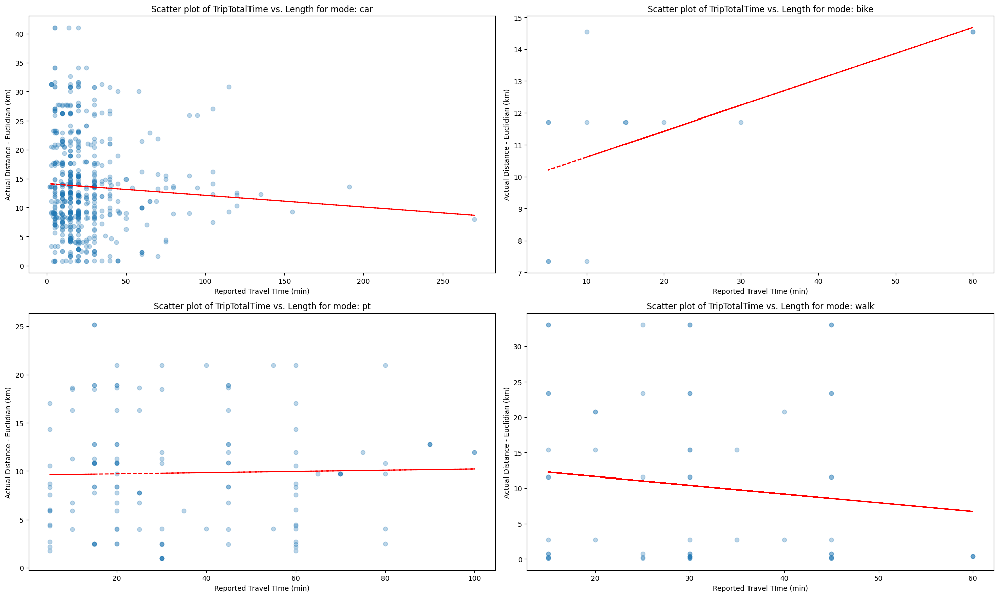

In [63]:

# plot the scatter plot of actual and reported activities
for activity_type in unique_activity_types:
    plot_scatter_actual_reported(
        activities=activity_chains_all_plot,
        activity_type=activity_type,
        activity_type_col="destination activity",
        x_col="TripTotalTime",
        y_col="length",
        x_label="Reported Travel TIme (min)",
        y_label="Actual Distance - Euclidian (km)",
        title_prefix="Scatter plot of TripTotalTime vs. Length",
        #save_dir=acbm.root_path / "data/processed/plots/assigning/",
    )

## Actual (euclidian) vs reported distances

In [54]:
# convert duration to numeric

activity_chains_all_plot["duration"] = pd.to_timedelta(activity_chains_all_plot["duration"], errors="coerce")
activity_chains_all_plot['duration'] = activity_chains_all_plot['duration'].apply(lambda x: x + pd.Timedelta(days=1) if x.days < 0 else x)
activity_chains_all_plot["duration"] = activity_chains_all_plot["duration"].dt.total_seconds() / 60
activity_chains_all_plot["duration"] = activity_chains_all_plot["duration"].astype(int)
activity_chains_all_plot.head(10)

,pid,hid,ozone,dzone,purp,origin activity,destination activity,mode,seq,tst,tet,duration,start_location_id,start_location_geometry,end_location_id,end_location_geometry,TripTotalTime,TripDisIncSW
0,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
1,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),5.0,1.0
2,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),45.0,6.0
3,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
4,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
5,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),20.0,13.0
6,199,89,E00059031,E00057751,other,home,other,walk,1.0,1900-01-01 10:00:00,1900-01-01 10:45:00,45,1736846224,POINT (-1.3972101197321274 53.934216722150346),790099150,POINT (-1.6403755497689254 53.84066696985774),15.0,4.0
7,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,45,790099150,POINT (-1.6403755497689254 53.84066696985774),1736846224,POINT (-1.3972101197321274 53.934216722150346),30.0,13.0
8,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,45,790099150,POINT (-1.6403755497689254 53.84066696985774),1736846224,POINT (-1.3972101197321274 53.934216722150346),5.0,1.0
9,199,89,E00057751,E00059031,home,other,home,walk,2.0,1900-01-01 10:45:00,1900-01-01 11:30:00,45,790099150,POINT (-1.6403755497689254 53.84066696985774),1736846224,POINT (-1.3972101197321274 53.934216722150346),45.0,6.0


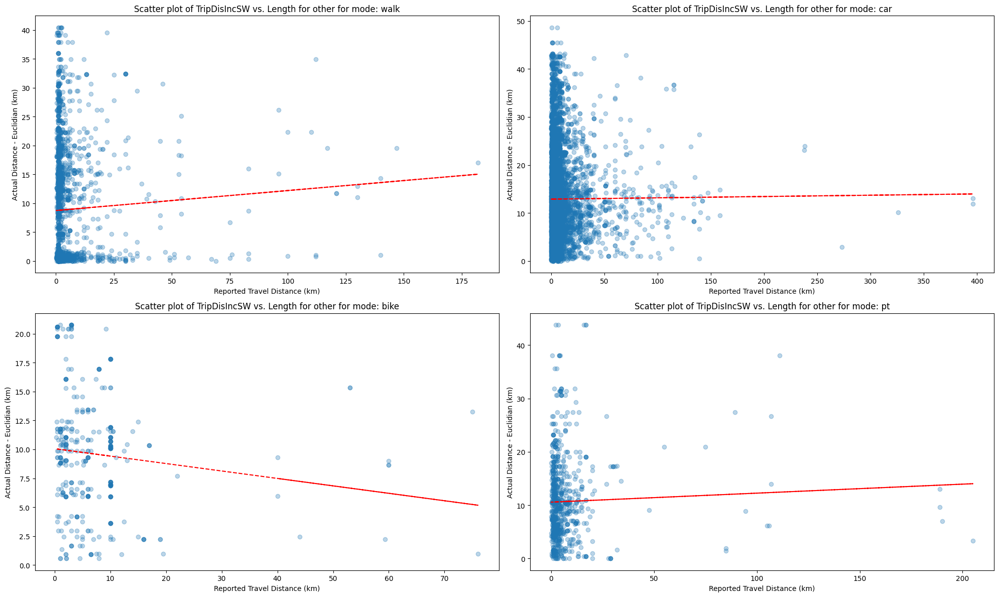

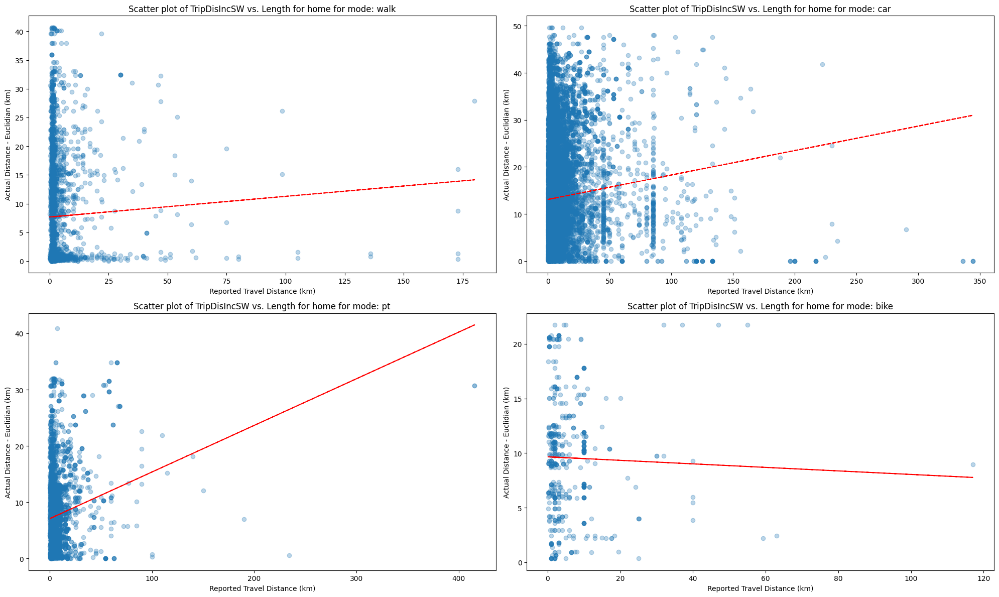

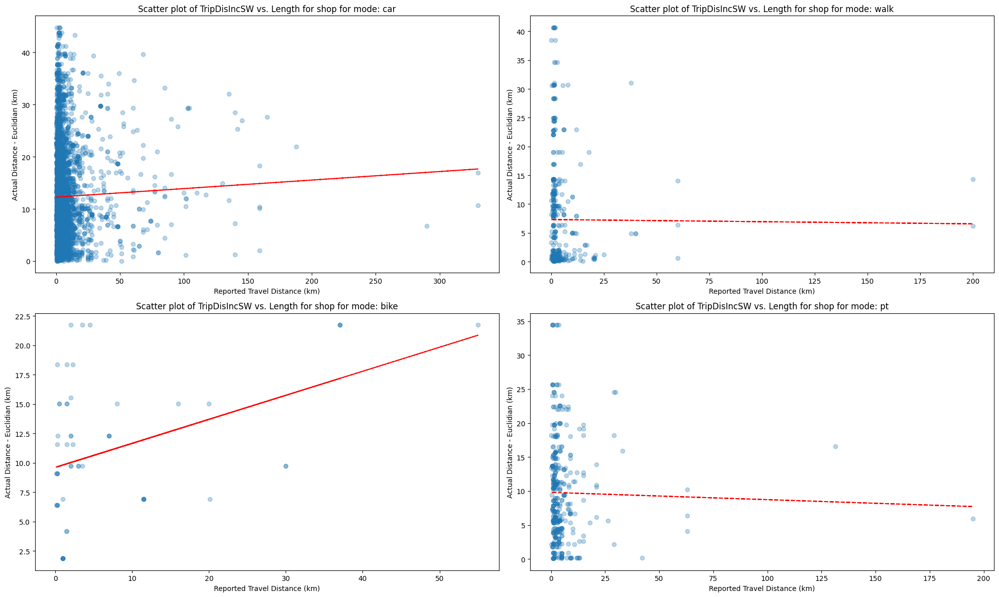

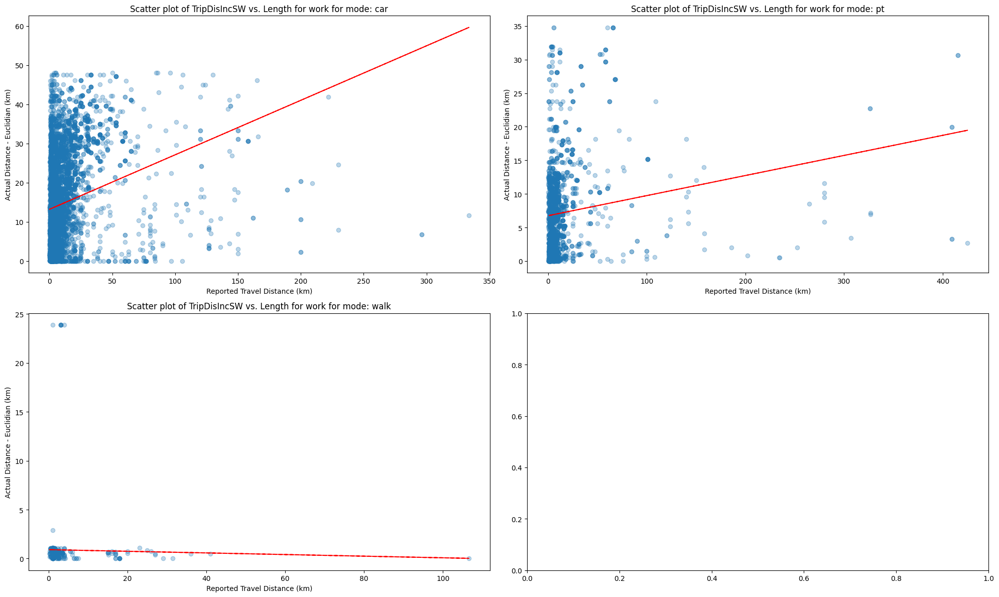

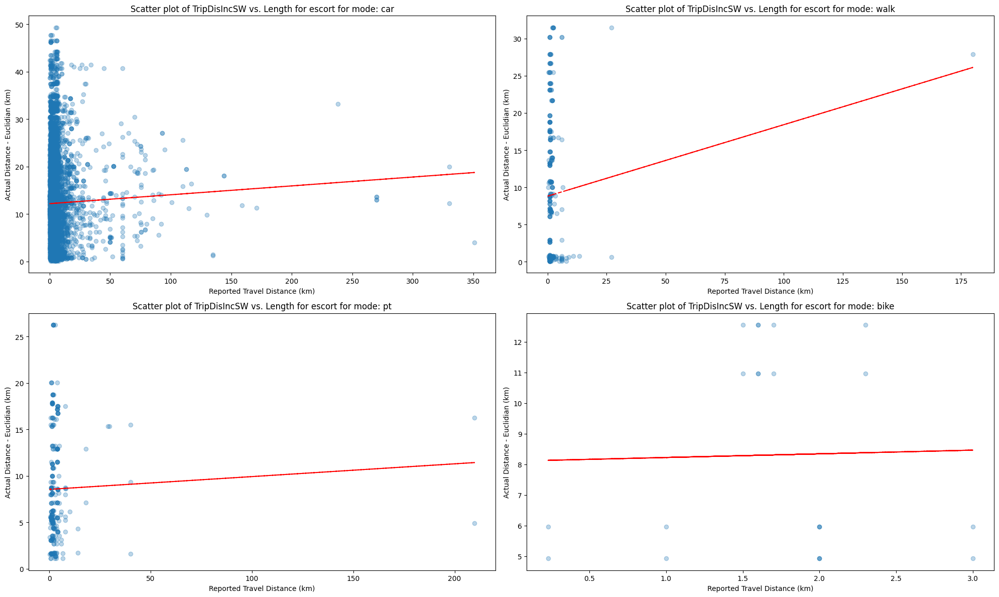

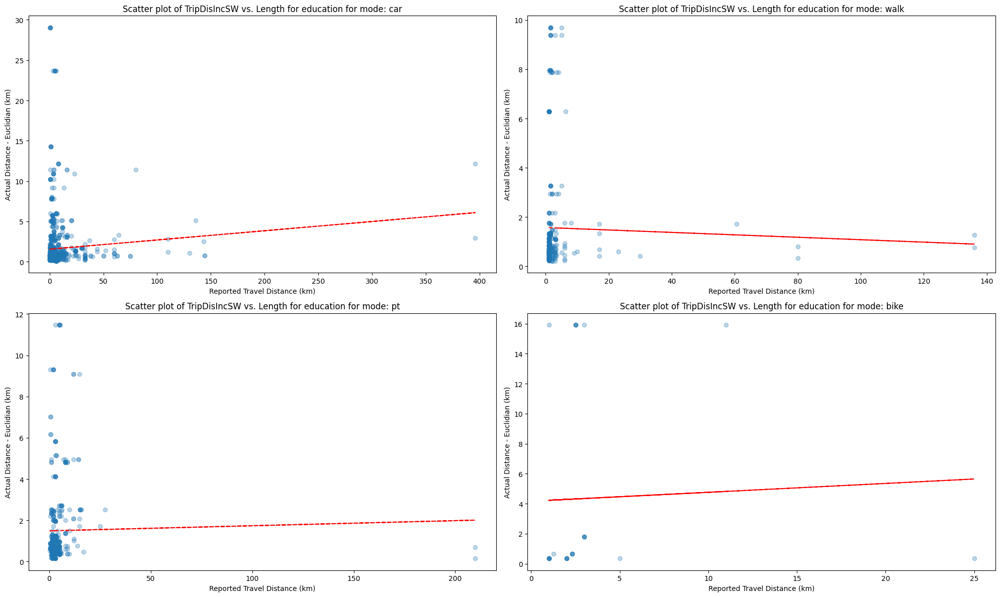

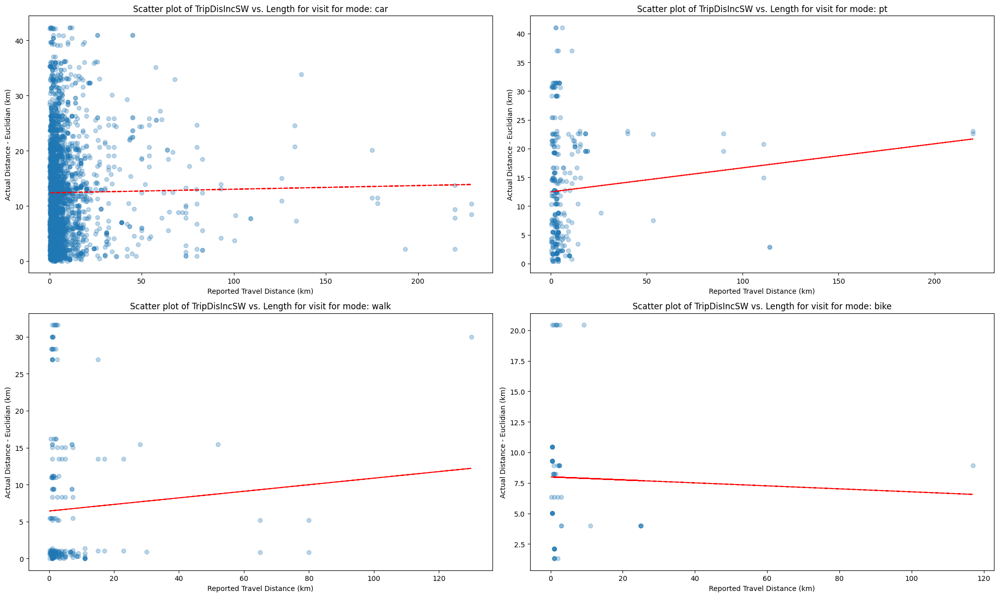

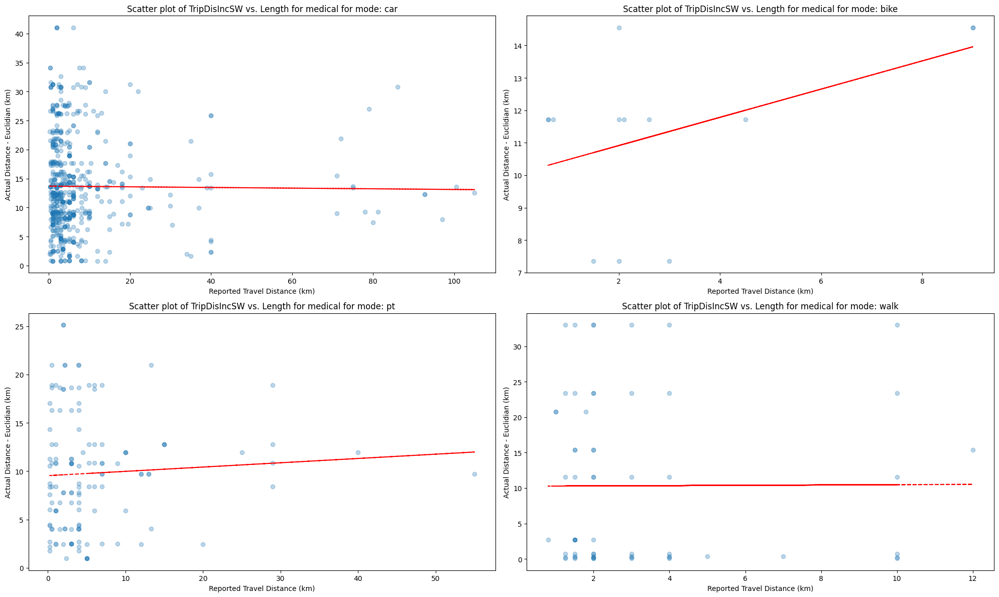

In [57]:
# Iterate over each unique activity type and create a plot
for activity_type in unique_activity_types:
    plot_scatter_actual_reported(
        activities=activity_chains_all_plot,
        activity_type=activity_type,
        activity_type_col="destination activity",
        x_col="TripDisIncSW",
        y_col="length",
        x_label="Reported Travel Distance (km)",
        y_label="Actual Distance - Euclidian (km)",
        title_prefix=f"Scatter plot of TripDisIncSW vs. Length for {activity_type}",
        # save_dir=acbm.root_path / "data/processed/plots/assigning/",
    )

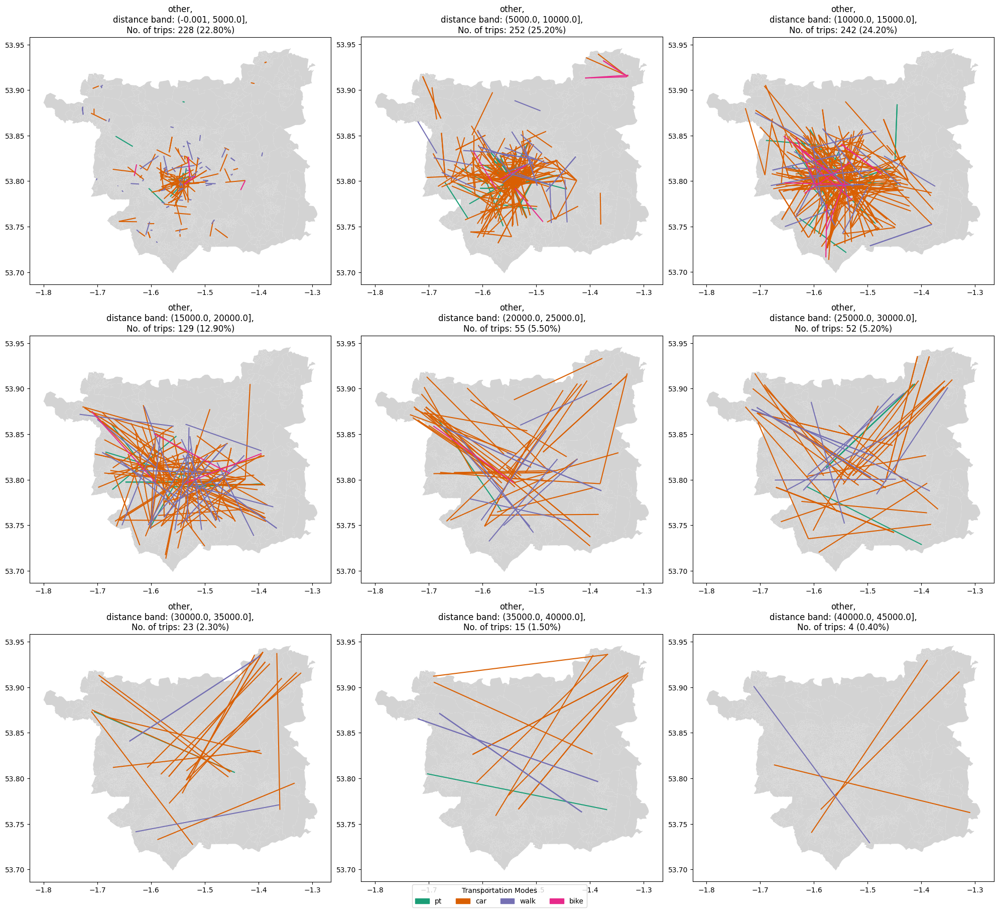

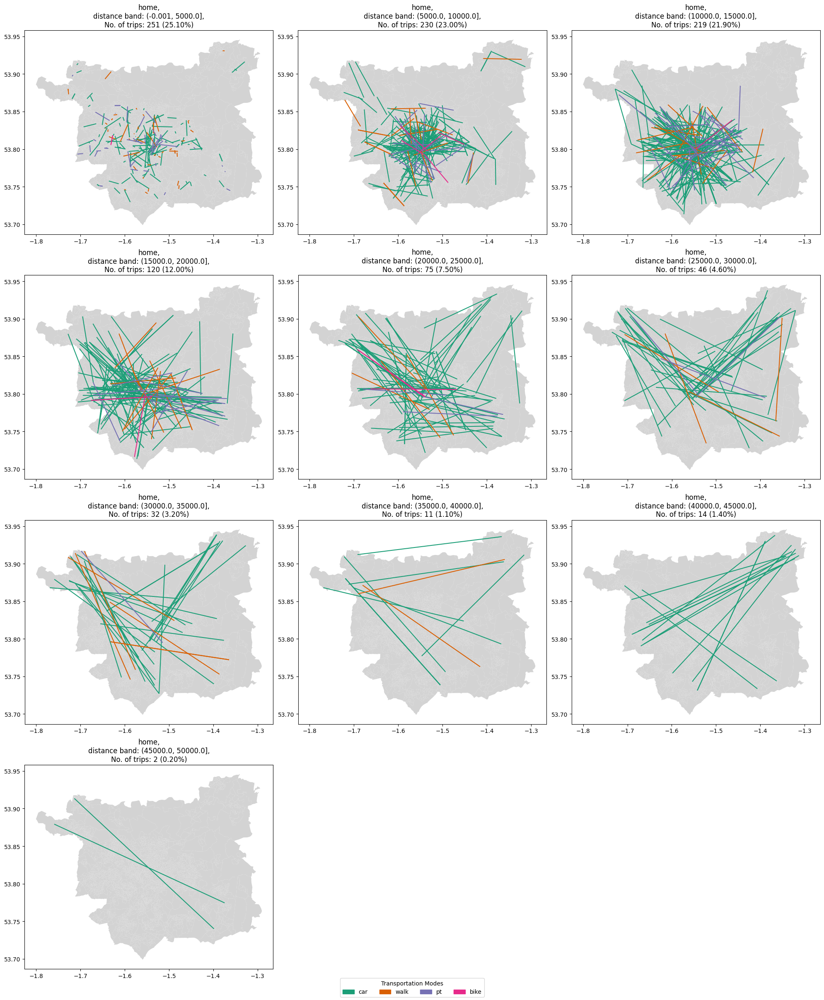

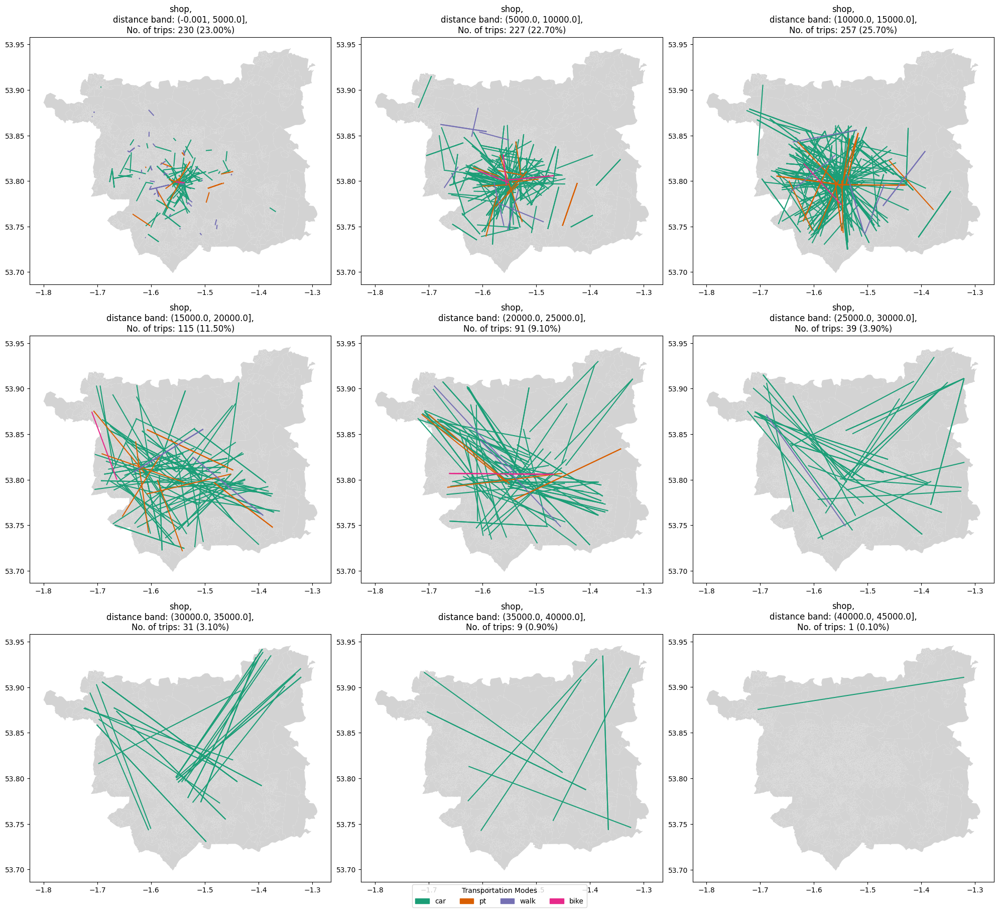

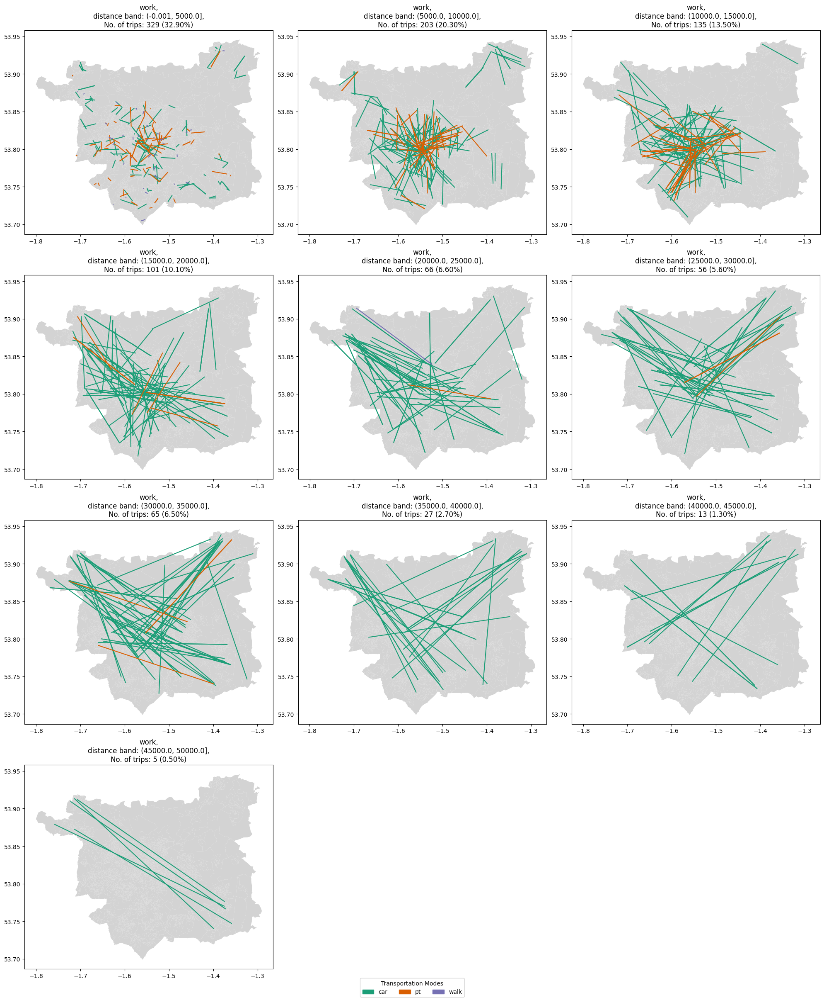

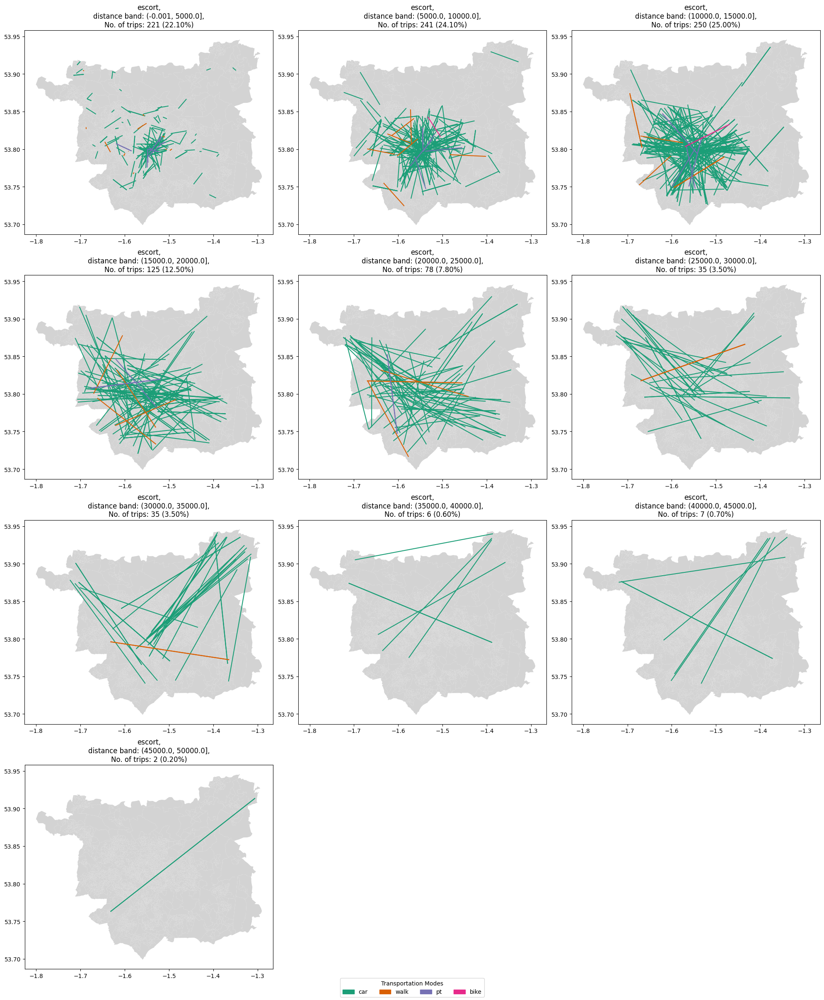

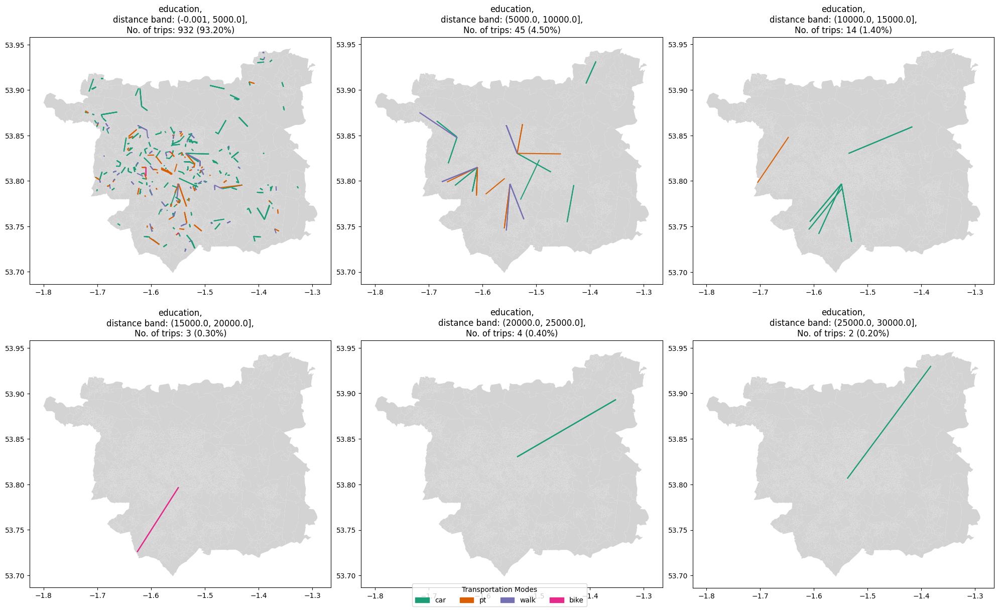

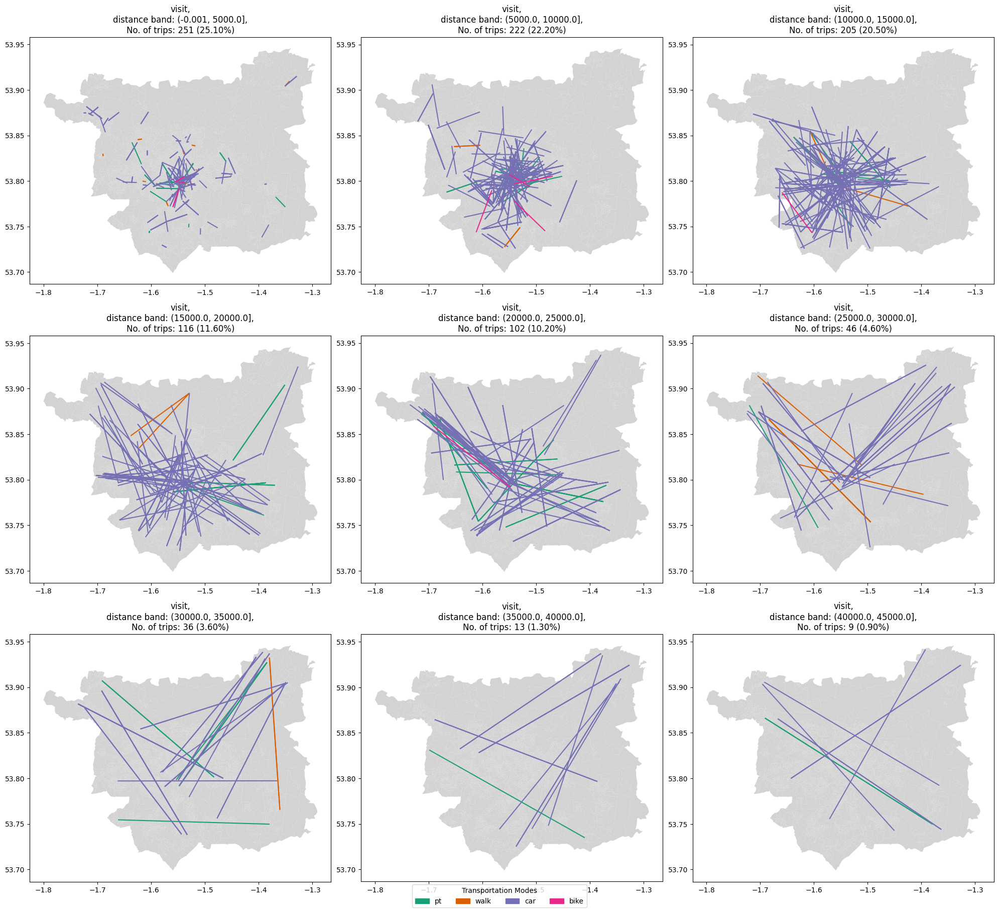

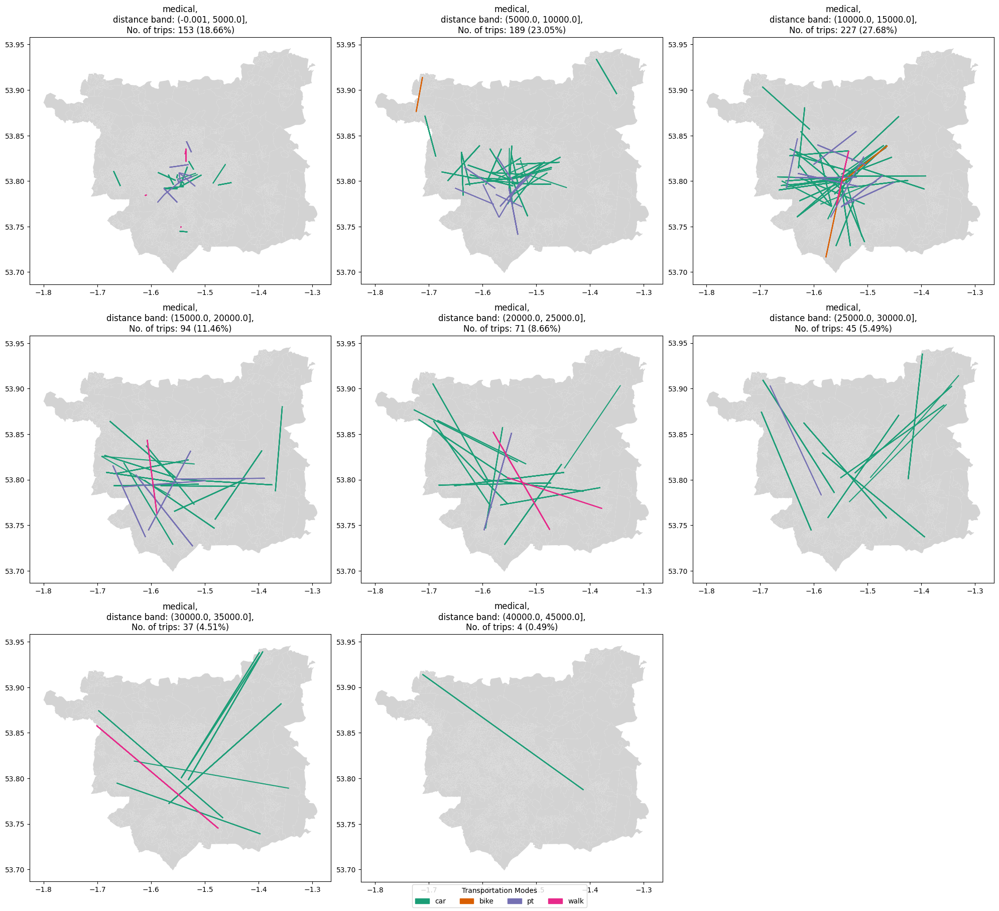

In [64]:
for activity_type in unique_activity_types:
    plot_desire_lines(
        activities=activity_chains_all_plot,
        activity_type_col="destination activity",
        activity_type=activity_type,
        bin_size=5000,
        boundaries=boundaries,
        sample_size=1000,
        #save_dir=acbm.root_path / "data/processed/plots/assigning/",
    )